In [ ]:
!pip install mediapipe


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 36.1/36.1 MB 18.1 MB/s eta 0:00:00


In [ ]:
import mediapipe as mp
import cv2
import numpy as np
import pandas as pd
import datetime
from sklearn.preprocessing import StandardScaler
from sklearn.calibration import CalibratedClassifierCV
import pickle
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression, SGDClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import precision_score, accuracy_score, f1_score, recall_score, confusion_matrix
import warnings
warnings.filterwarnings('ignore')

# Drawing helpers
mp_drawing = mp.solutions.drawing_utils
mp_pose = mp.solutions.pose

In [ ]:
# Determine important landmarks for plank
IMPORTANT_LMS = [
    "NOSE",
    "LEFT_SHOULDER",
    "RIGHT_SHOULDER",
    "RIGHT_ELBOW",
    "LEFT_ELBOW",
    "RIGHT_WRIST",
    "LEFT_WRIST",
    "LEFT_HIP",
    "RIGHT_HIP",
]

# Generate all columns of the data frame

HEADERS = ["label"] # Label column

for lm in IMPORTANT_LMS:
    HEADERS += [f"{lm.lower()}_x", f"{lm.lower()}_y", f"{lm.lower()}_z", f"{lm.lower()}_v"]

In [ ]:
def round_up_metric_results(results) -> list:
    '''Round up metrics results such as precision score, recall score, ...'''
    return list(map(lambda el: round(el, 3), results))

def describe_dataset(dataset_path: str):
    '''
    Describe dataset
    '''

    data = pd.read_csv(dataset_path)
    print(f"Headers: {list(data.columns.values)}")
    print(f'Number of rows: {data.shape[0]} \nNumber of columns: {data.shape[1]}\n')
    print(f"Labels: \n{data['label'].value_counts()}\n")
    print(f"Missing values: {data.isnull().values.any()}\n")

    duplicate = data[data.duplicated()]
    print(f"Duplicate Rows : {len(duplicate.sum(axis=1))}")

    return data

In [ ]:
# load dataset
df = describe_dataset("/content/train.csv")

# Categorizing label
df.loc[df["label"] == "C", "label"] = 0
df.loc[df["label"] == "L", "label"] = 1

Headers: ['label', 'nose_x', 'nose_y', 'nose_z', 'nose_v', 'left_shoulder_x', 'left_shoulder_y', 'left_shoulder_z', 'left_shoulder_v', 'right_shoulder_x', 'right_shoulder_y', 'right_shoulder_z', 'right_shoulder_v', 'right_elbow_x', 'right_elbow_y', 'right_elbow_z', 'right_elbow_v', 'left_elbow_x', 'left_elbow_y', 'left_elbow_z', 'left_elbow_v', 'right_wrist_x', 'right_wrist_y', 'right_wrist_z', 'right_wrist_v', 'left_wrist_x', 'left_wrist_y', 'left_wrist_z', 'left_wrist_v', 'left_hip_x', 'left_hip_y', 'left_hip_z', 'left_hip_v', 'right_hip_x', 'right_hip_y', 'right_hip_z', 'right_hip_v']
Number of rows: 15372 
Number of columns: 37

Labels: 
label
C    8238
L    7134
Name: count, dtype: int64

Missing values: False

Duplicate Rows : 0


In [ ]:
sc = StandardScaler()

In [ ]:

# Select features and drop the label
x = df.drop("label", axis=1)
y = df["label"].astype('int')

# Fit the scaler on the features and then transform the data
x_scaled = sc.fit_transform(x)

# Convert the scaled data back to a DataFrame
x_scaled = pd.DataFrame(x_scaled, columns=x.columns)

# Now, x_scaled contains the scaled features


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=1234)
y_train

,label
9465,1
8833,0
6190,0
7645,0
13890,1
...,...
11468,1
7221,1
1318,1
8915,1


In [ ]:
algorithms =[("LR", LogisticRegression()),
         ("SVC", SVC(probability=True)),
         ('KNN',KNeighborsClassifier()),
         ("DTC", DecisionTreeClassifier()),
         ("SGDC", CalibratedClassifierCV(SGDClassifier())),
         ("NB", GaussianNB()),
         ('RF', RandomForestClassifier()),]

models = {}
final_results = []

for name, model in algorithms:
    trained_model = model.fit(X_train, y_train)
    models[name] = trained_model

    # Evaluate model
    model_results = model.predict(X_test)

    p_score = precision_score(y_test, model_results, average=None, labels=[0, 1])
    a_score = accuracy_score(y_test, model_results)
    r_score = recall_score(y_test, model_results, average=None, labels=[0, 1])
    f1_score_result = f1_score(y_test, model_results, average=None, labels=[0, 1])
    cm = confusion_matrix(y_test, model_results, labels=[0, 1])
    final_results.append(( name,  round_up_metric_results(p_score), a_score, round_up_metric_results(r_score), round_up_metric_results(f1_score_result), cm))

# Sort results by F1 score
final_results.sort(key=lambda k: sum(k[4]), reverse=True)
pd.DataFrame(final_results, columns=["Model", "Precision Score", "Accuracy score", "Recall Score", "F1 score", "Confusion Matrix"])

,Model,Precision Score,Accuracy score,Recall Score,F1 score,Confusion Matrix
0,RF,"[0.999, 0.999]",0.999024,"[0.999, 0.999]","[0.999, 0.999]","[[1677, 2], [1, 1395]]"
1,KNN,"[0.994, 0.997]",0.995447,"[0.998, 0.993]","[0.996, 0.995]","[[1675, 4], [10, 1386]]"
2,DTC,"[0.996, 0.99]",0.993171,"[0.992, 0.995]","[0.994, 0.992]","[[1665, 14], [7, 1389]]"
3,SVC,"[0.993, 0.984]",0.988943,"[0.987, 0.991]","[0.99, 0.988]","[[1657, 22], [12, 1384]]"
4,SGDC,"[0.97, 0.94]",0.956098,"[0.949, 0.965]","[0.959, 0.952]","[[1593, 86], [49, 1347]]"
5,LR,"[0.958, 0.912]",0.936260,"[0.924, 0.951]","[0.941, 0.931]","[[1551, 128], [68, 1328]]"
6,NB,"[0.927, 0.842]",0.884878,"[0.857, 0.918]","[0.89, 0.879]","[[1439, 240], [114, 1282]]"


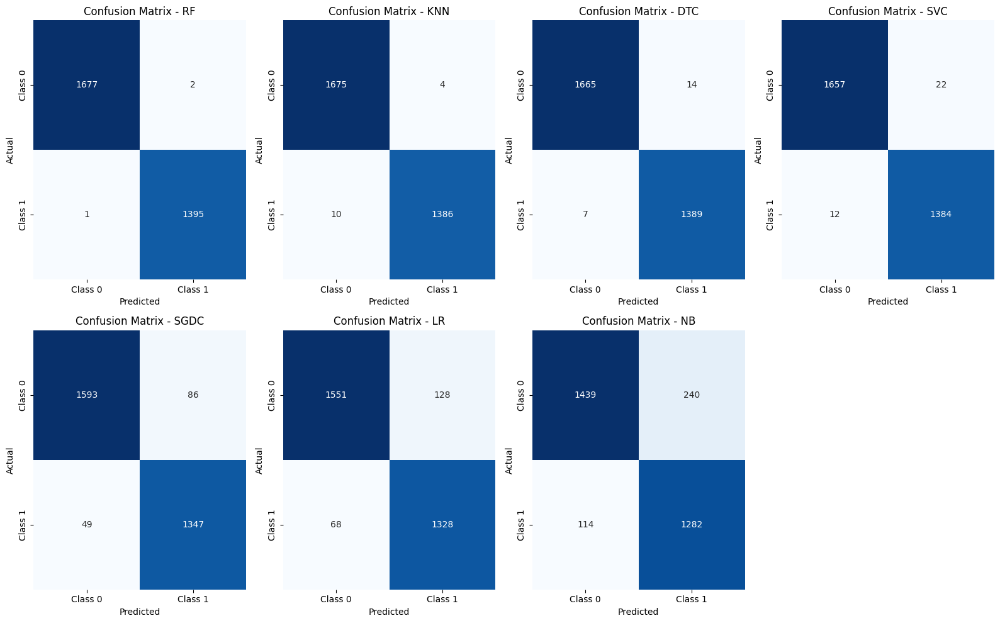

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import math

# Number of models
n_models = len(final_results)
cols = 4  # Number of columns for subplots
rows = math.ceil(n_models / cols)  # Calculate rows dynamically based on the number of models

# Create a dynamic grid for subplots
fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(16, rows * 5))
axes = axes.flatten()  # Flatten the axes for easier iteration

# Loop through each model's results and plot the confusion matrix
for idx, (name, p_score, a_score, r_score, f1_score_result, cm) in enumerate(final_results):
    sns.heatmap(cm, annot=True, fmt='d', cmap="Blues", cbar=False,
                xticklabels=["Class 0", "Class 1"], yticklabels=["Class 0", "Class 1"], ax=axes[idx])
    axes[idx].set_title(f"Confusion Matrix - {name}")
    axes[idx].set_xlabel("Predicted")
    axes[idx].set_ylabel("Actual")

# Remove any empty subplots (if the number of models is not a perfect multiple of the columns)
for i in range(n_models, len(axes)):
    fig.delaxes(axes[i])

# Adjust layout for better spacing
plt.tight_layout()
plt.show()


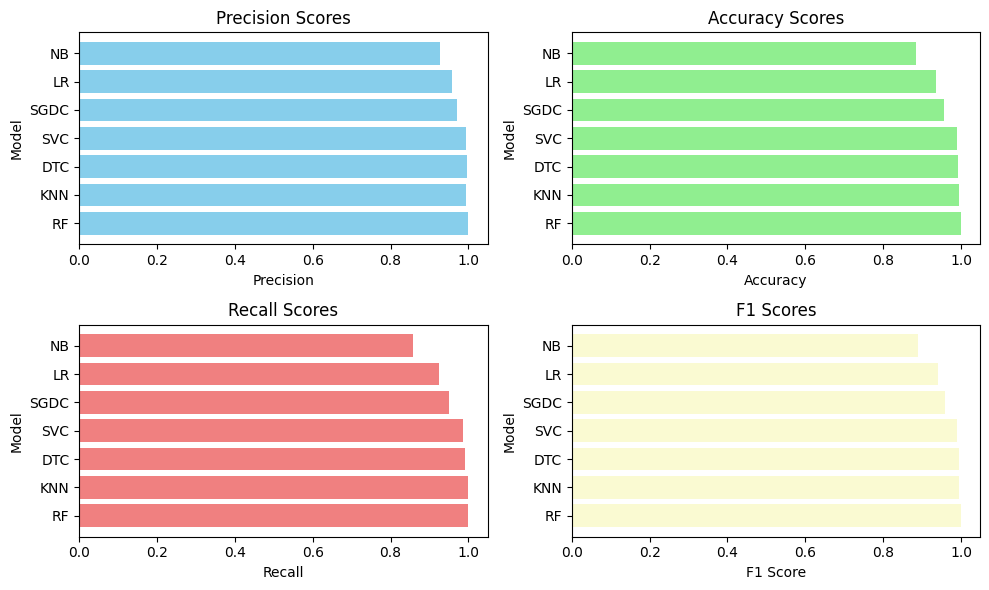

In [ ]:
import matplotlib.pyplot as plt

# Prepare data for plotting metrics
model_names = [result[0] for result in final_results]  # Model names
precision_scores = [result[1][0] for result in final_results]  # Extract first value of precision (scalar)
accuracy_scores = [result[2] for result in final_results]  # Accuracy scores (already scalar)
recall_scores = [result[3][0] for result in final_results]  # Extract first value of recall (scalar)
f1_scores = [result[4][0] for result in final_results]  # Extract first value of F1 score (scalar)

# Ensure all lists have the correct shape (1D arrays)
assert len(model_names) == len(precision_scores) == len(accuracy_scores) == len(recall_scores) == len(f1_scores), "Shape mismatch between model names and scores"

# Set up a figure for plotting
fig, axes = plt.subplots(2, 2, figsize=(10, 6))

# Precision plot
axes[0, 0].barh(model_names, precision_scores, color='skyblue')
axes[0, 0].set_title('Precision Scores')
axes[0, 0].set_xlabel('Precision')
axes[0, 0].set_ylabel('Model')

# Accuracy plot
axes[0, 1].barh(model_names, accuracy_scores, color='lightgreen')
axes[0, 1].set_title('Accuracy Scores')
axes[0, 1].set_xlabel('Accuracy')
axes[0, 1].set_ylabel('Model')

# Recall plot
axes[1, 0].barh(model_names, recall_scores, color='lightcoral')
axes[1, 0].set_title('Recall Scores')
axes[1, 0].set_xlabel('Recall')
axes[1, 0].set_ylabel('Model')

# F1 score plot
axes[1, 1].barh(model_names, f1_scores, color='lightgoldenrodyellow')
axes[1, 1].set_title('F1 Scores')
axes[1, 1].set_xlabel('F1 Score')
axes[1, 1].set_ylabel('Model')

# Adjust layout for better spacing
plt.tight_layout()
plt.show()


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from tensorflow.keras.utils import to_categorical



In [ ]:
KNN_cm = final[ eval_df["Model"] == 'RF' ]["Confusion Matrix"].values[0]

cm_array_df = pd.DataFrame(KNN_cm, index=["C", "L"], columns=["C", "L"])

fig, ax = plt.subplots(figsize=(8,4))
sns.heatmap(cm_array_df, linewidths=1, annot=True, ax=ax, fmt='g')

NameError: name 'final' is not defined

In [ ]:
import os
import pickle
import zipfile
from google.colab import files

# Define the directory and filename for saving the model
model_directory = "/content/Bicep"
model_filename = "err_LR_model.pkl"
model_path = os.path.join(model_directory, model_filename)

# Ensure the directory exists
os.makedirs(model_directory, exist_ok=True)

# Save the model using pickle (assuming 'models["LR"]' is the model you want to save)
with open(model_path, "wb") as f:
    pickle.dump(models["LR"], f)

# Create a zip file containing the saved model
zip_filename = "err_LR_model.zip"
zip_filepath = os.path.join("/content", zip_filename)

# Create a zip file
with zipfile.ZipFile(zip_filepath, 'w', zipfile.ZIP_DEFLATED) as zipf:
    zipf.write(model_path, os.path.basename(model_path))

# Provide a download link for the zip file
files.download(zip_filepath)

print(f"Model saved and zipped. You can download it from the link above.")


In [ ]:
testset_final_results = []

for name, model in sklearn_models.items():
    # Evaluate model
    model_results = model.predict(test_x)

    p_score = precision_score(test_y, model_results, average="macro")
    a_score = accuracy_score(test_y, model_results)
    r_score = recall_score(test_y, model_results, average="macro")
    f1_score_result = f1_score(test_y, model_results, average="macro")
    cm = confusion_matrix(test_y, model_results, labels=[0, 1])
    testset_final_results.append(( name,  p_score, r_score, a_score, f1_score_result, cm ))


sklearn_eval = pd.DataFrame(testset_final_results, columns=["Model", "Precision Score", "Recall Score", "Accuracy Score", "F1 Score", "Confusion Matrix"])

sklearn_eval

NameError: name 'sklearn_models' is not defined

In [ ]:
def rescale_frame(frame, percent=50):
    '''
    Rescale a frame from OpenCV to a certain percentage compare to its original frame
    '''
    width = int(frame.shape[1] * percent/ 100)
    height = int(frame.shape[0] * percent/ 100)
    dim = (width, height)
    return cv2.resize(frame, dim, interpolation =cv2.INTER_AREA)


def save_frame_as_image(frame, message: str = None):
    '''
    Save a frame as image to display the error
    '''
    now = datetime.datetime.now()

    if message:
        cv2.putText(frame, message, (50, 150), cv2.FONT_HERSHEY_COMPLEX, 0.4, (0, 0, 0), 1, cv2.LINE_AA)

    print("Saving ...")
    cv2.imwrite(f"../data/logs/bicep_{now}.jpg", frame)


def calculate_angle(point1: list, point2: list, point3: list) -> float:
    '''
    Calculate the angle between 3 points
    Unit of the angle will be in Degree
    '''
    point1 = np.array(point1)
    point2 = np.array(point2)
    point3 = np.array(point3)

    # Calculate algo
    angleInRad = np.arctan2(point3[1] - point2[1], point3[0] - point2[0]) - np.arctan2(point1[1] - point2[1], point1[0] - point2[0])
    angleInDeg = np.abs(angleInRad * 180.0 / np.pi)

    angleInDeg = angleInDeg if angleInDeg <= 180 else 360 - angleInDeg
    return angleInDeg


def extract_important_keypoints(results, important_landmarks: list) -> list:
    '''
    Extract important keypoints from mediapipe pose detection
    '''
    landmarks = results.pose_landmarks.landmark

    data = []
    for lm in important_landmarks:
        keypoint = landmarks[mp_pose.PoseLandmark[lm].value]
        data.append([keypoint.x, keypoint.y, keypoint.z, keypoint.visibility])

    return np.array(data).flatten().tolist()

In [ ]:
class BicepPoseAnalysis:
    def __init__(self, side: str, stage_down_threshold: float, stage_up_threshold: float, peak_contraction_threshold: float, loose_upper_arm_angle_threshold: float, visibility_threshold: float):
        # Initialize thresholds
        self.stage_down_threshold = stage_down_threshold
        self.stage_up_threshold = stage_up_threshold
        self.peak_contraction_threshold = peak_contraction_threshold
        self.loose_upper_arm_angle_threshold = loose_upper_arm_angle_threshold
        self.visibility_threshold = visibility_threshold

        self.side = side
        self.counter = 0
        self.stage = "down"
        self.is_visible = True
        self.detected_errors = {
            "LOOSE_UPPER_ARM": 0,
            "PEAK_CONTRACTION": 0,
        }

        # Params for loose upper arm error detection
        self.loose_upper_arm = False

        # Params for peak contraction error detection
        self.peak_contraction_angle = 1000
        self.peak_contraction_frame = None

    def get_joints(self, landmarks) -> bool:
        '''
        Check for joints' visibility then get joints coordinate
        '''
        side = self.side.upper()

        # Check visibility
        joints_visibility = [ landmarks[mp_pose.PoseLandmark[f"{side}_SHOULDER"].value].visibility, landmarks[mp_pose.PoseLandmark[f"{side}_ELBOW"].value].visibility, landmarks[mp_pose.PoseLandmark[f"{side}_WRIST"].value].visibility ]

        is_visible = all([ vis > self.visibility_threshold for vis in joints_visibility ])
        self.is_visible = is_visible

        if not is_visible:
            return self.is_visible

        # Get joints' coordinates
        self.shoulder = [ landmarks[mp_pose.PoseLandmark[f"{side}_SHOULDER"].value].x, landmarks[mp_pose.PoseLandmark[f"{side}_SHOULDER"].value].y ]
        self.elbow = [ landmarks[mp_pose.PoseLandmark[f"{side}_ELBOW"].value].x, landmarks[mp_pose.PoseLandmark[f"{side}_ELBOW"].value].y ]
        self.wrist = [ landmarks[mp_pose.PoseLandmark[f"{side}_WRIST"].value].x, landmarks[mp_pose.PoseLandmark[f"{side}_WRIST"].value].y ]

        return self.is_visible

    def analyze_pose(self, landmarks, frame):
        '''
        - Bicep Counter
        - Errors Detection
        '''
        self.get_joints(landmarks)

        # Cancel calculation if visibility is poor
        if not self.is_visible:
            return (None, None)

        # * Calculate curl angle for counter
        bicep_curl_angle = int(calculate_angle(self.shoulder, self.elbow, self.wrist))
        if bicep_curl_angle > self.stage_down_threshold:
            self.stage = "down"
        elif bicep_curl_angle < self.stage_up_threshold and self.stage == "down":
            self.stage = "up"
            self.counter += 1

        # * Calculate the angle between the upper arm (shoulder & joint) and the Y axis
        shoulder_projection = [ self.shoulder[0], 1 ] # Represent the projection of the shoulder to the X axis
        ground_upper_arm_angle = int(calculate_angle(self.elbow, self.shoulder, shoulder_projection))

        # * Evaluation for LOOSE UPPER ARM error
        if ground_upper_arm_angle > self.loose_upper_arm_angle_threshold:
            # Limit the saved frame
            if not self.loose_upper_arm:
                self.loose_upper_arm = True
                # save_frame_as_image(frame, f"Loose upper arm: {ground_upper_arm_angle}")
                self.detected_errors["LOOSE_UPPER_ARM"] += 1
        else:
            self.loose_upper_arm = False

        # * Evaluate PEAK CONTRACTION error
        if self.stage == "up" and bicep_curl_angle < self.peak_contraction_angle:
            # Save peaked contraction every rep
            self.peak_contraction_angle = bicep_curl_angle
            self.peak_contraction_frame = frame

        elif self.stage == "down":
            # * Evaluate if the peak is higher than the threshold if True, marked as an error then saved that frame
            if self.peak_contraction_angle != 1000 and self.peak_contraction_angle >= self.peak_contraction_threshold:
                # save_frame_as_image(self.peak_contraction_frame, f"{self.side} - Peak Contraction: {self.peak_contraction_angle}")
                self.detected_errors["PEAK_CONTRACTION"] += 1

            # Reset params
            self.peak_contraction_angle = 1000
            self.peak_contraction_frame = None

        return (bicep_curl_angle, ground_upper_arm_angle)

In [ ]:
VIDEO_DEMO_PATH = "/content/Incorrect (12).mp4"

In [ ]:
# Load input scaler
with open("/content/input_scaler.pkl", "rb") as f:
    input_scaler = pickle.load(f)

In [ ]:
import os

file_path = "/content/bicep_dp.pkl"
print("File exists:", os.path.exists(file_path))


File exists: True


In [ ]:
# Load model
with open("/content/KNN_model.pkl", "rb") as f:
    sklearn_model = pickle.load(f)

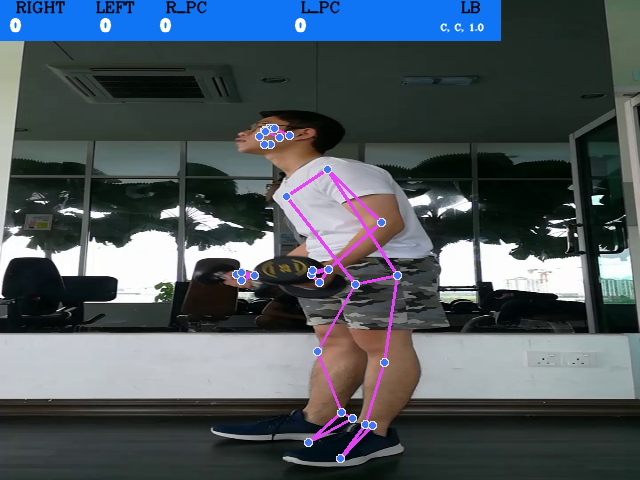

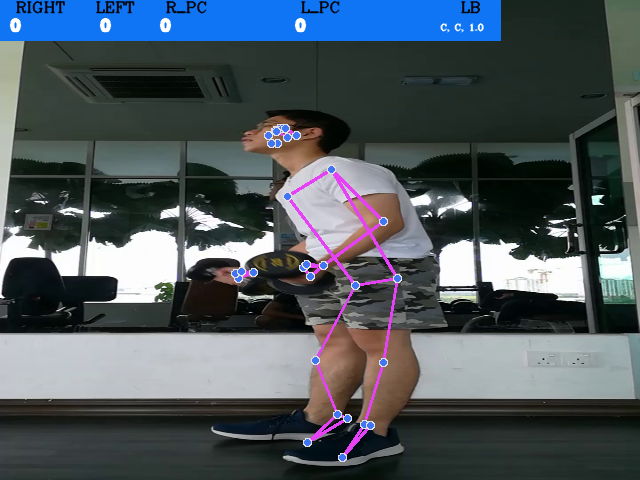

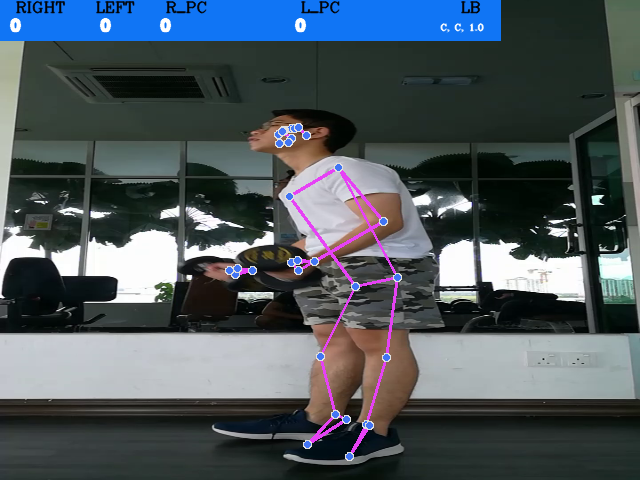

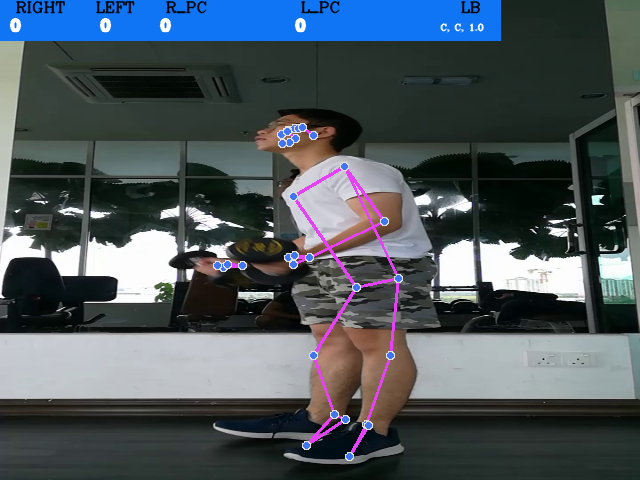

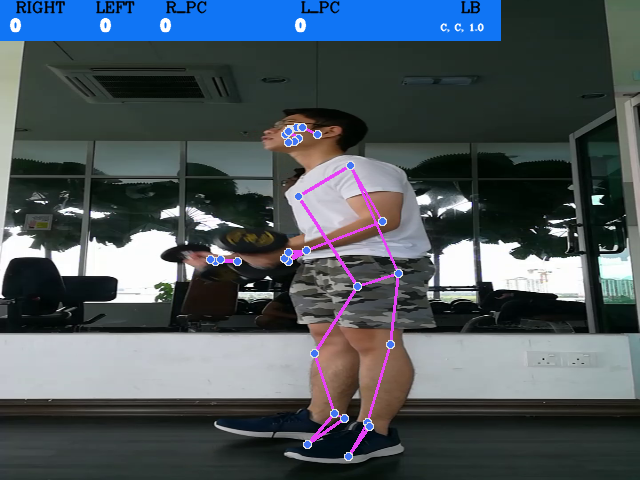

...

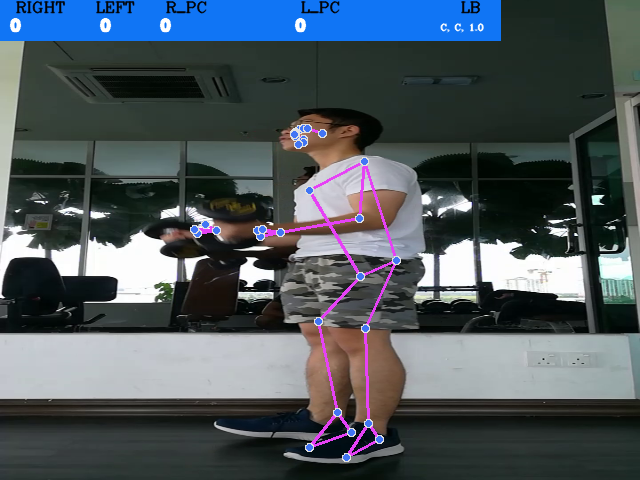

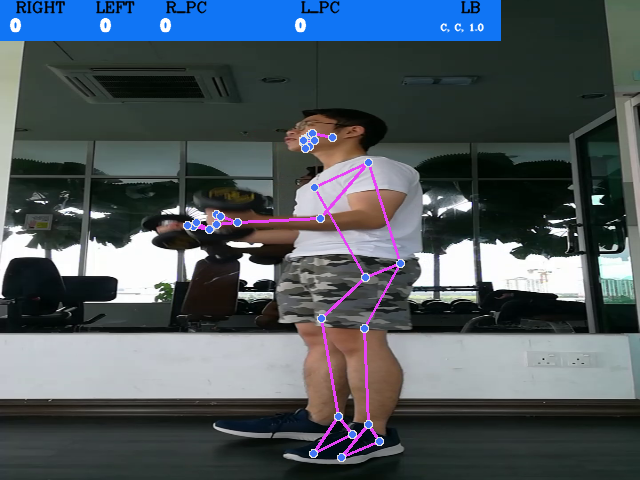

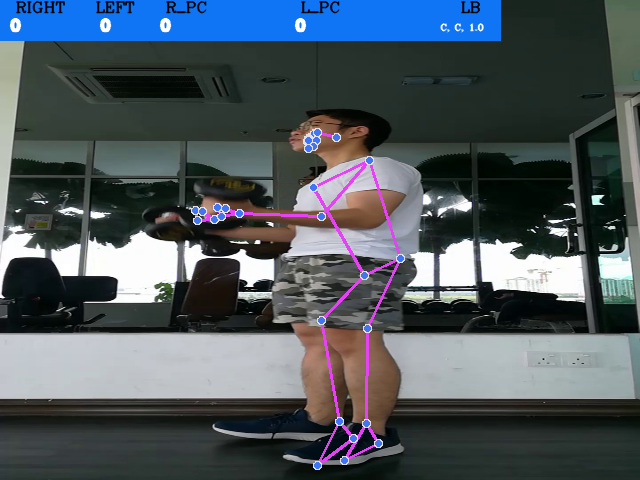

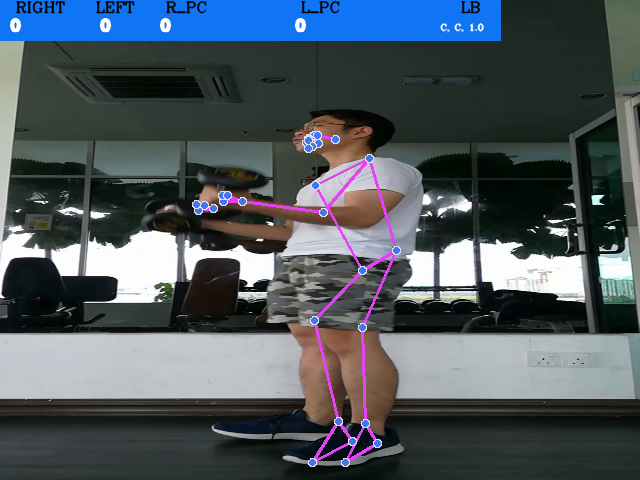

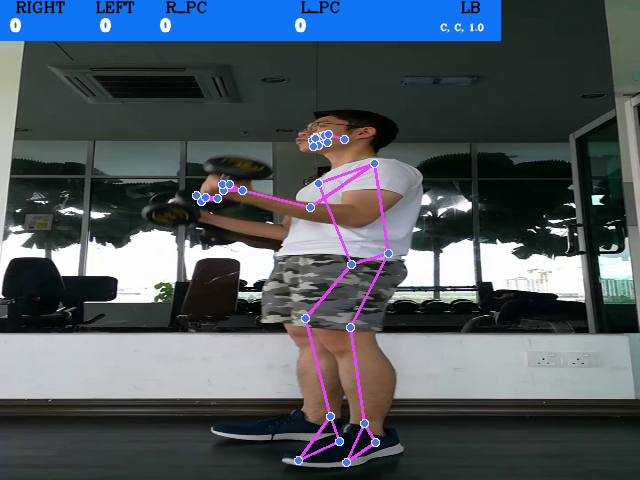

No human found
No human found


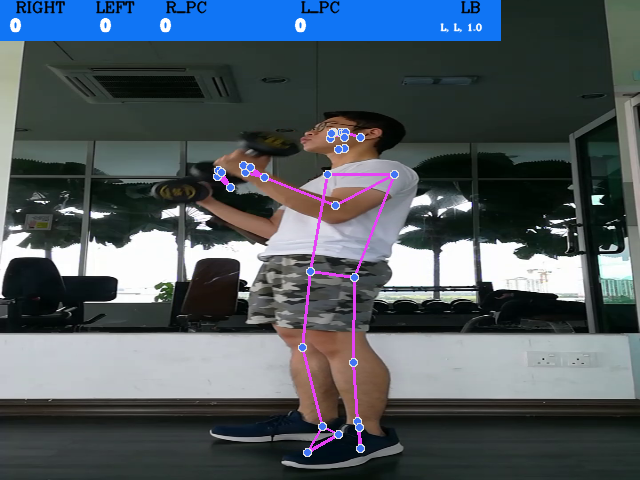

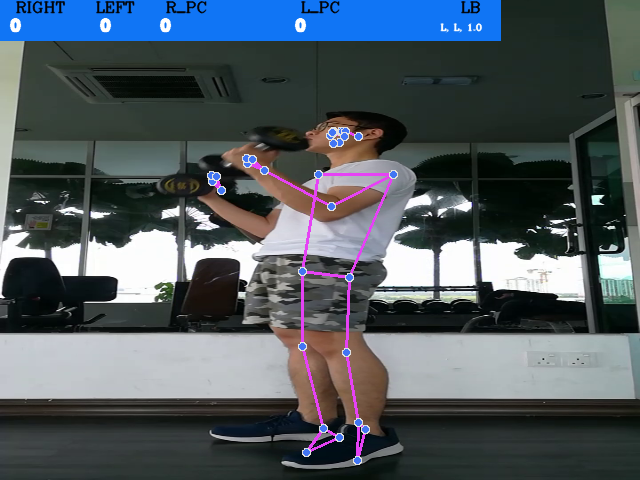

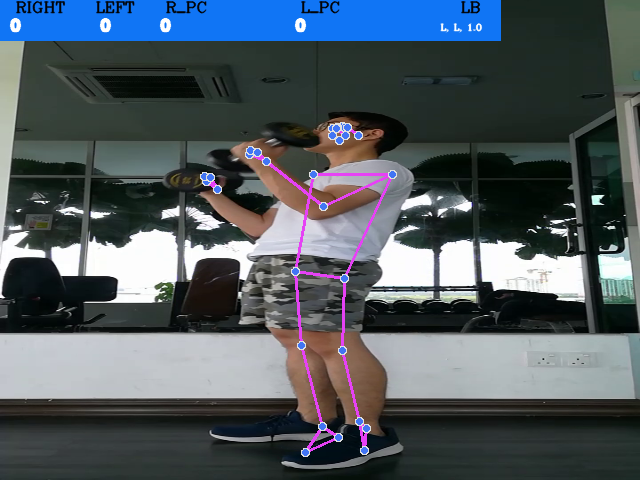

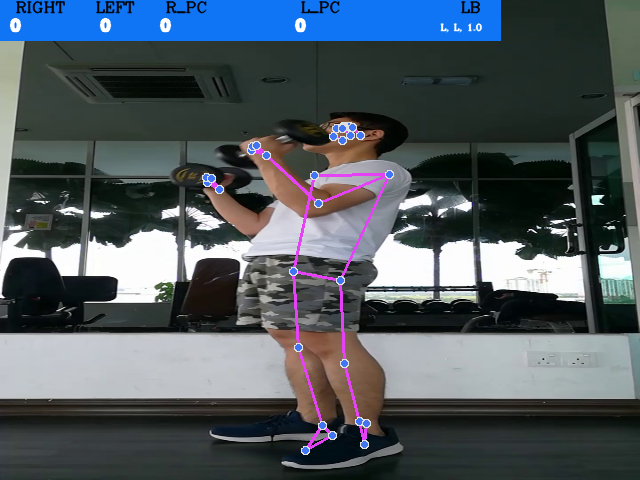

No human found
No human found
No human found
No human found
No human found


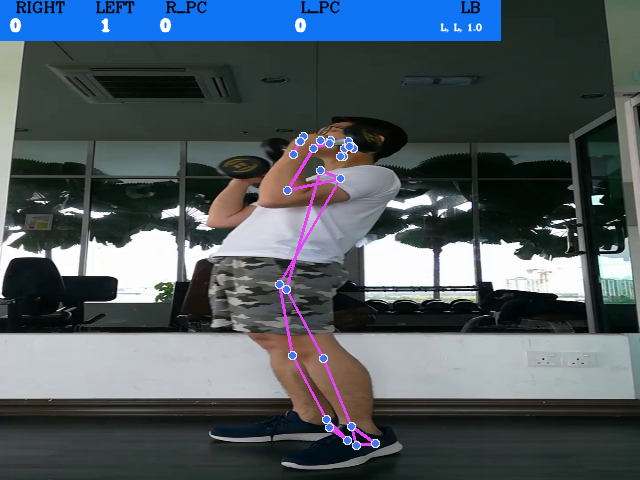

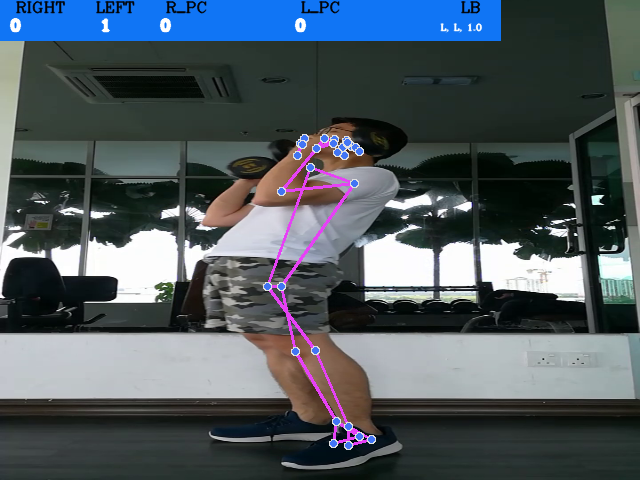

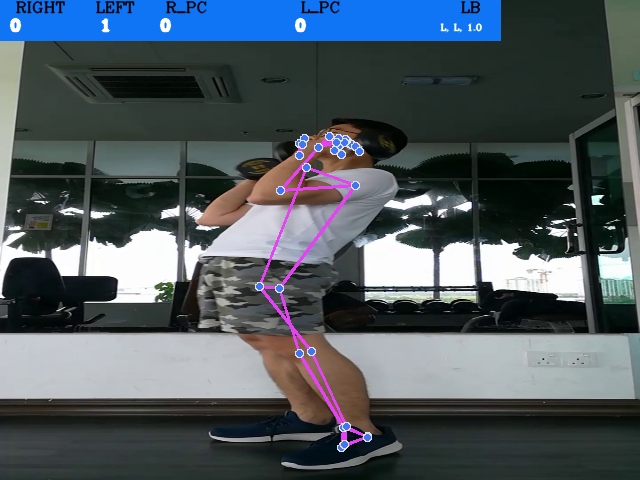

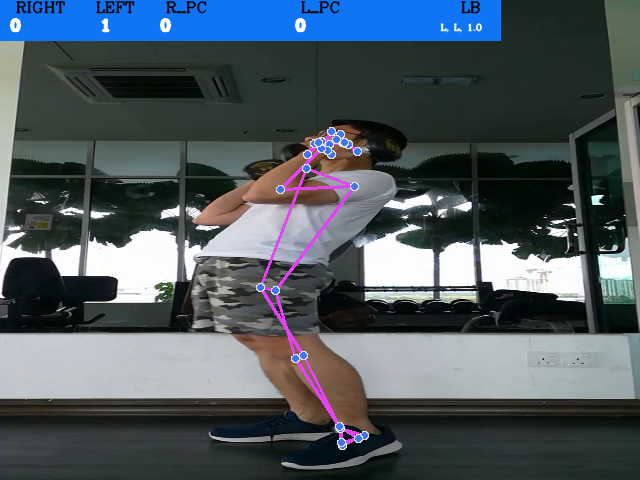

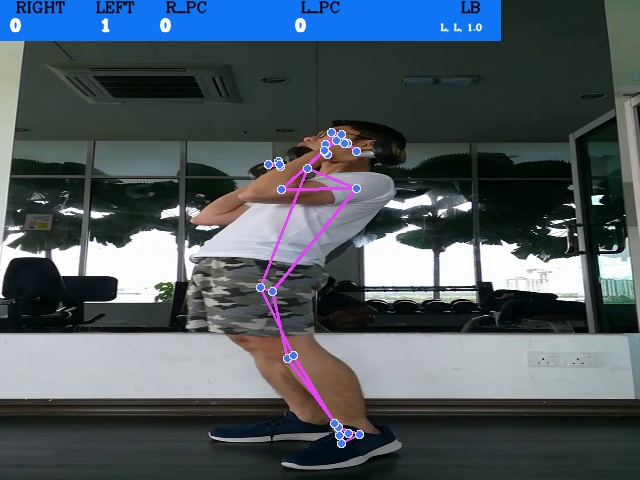

...

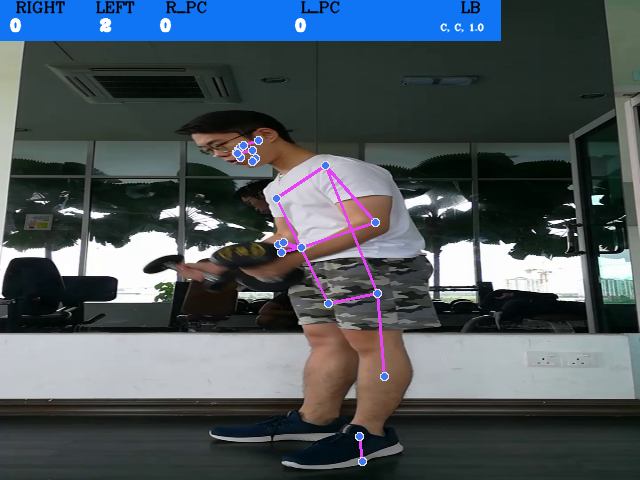

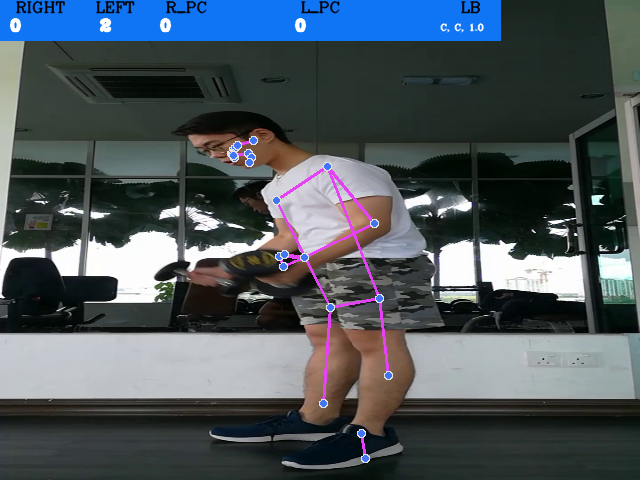

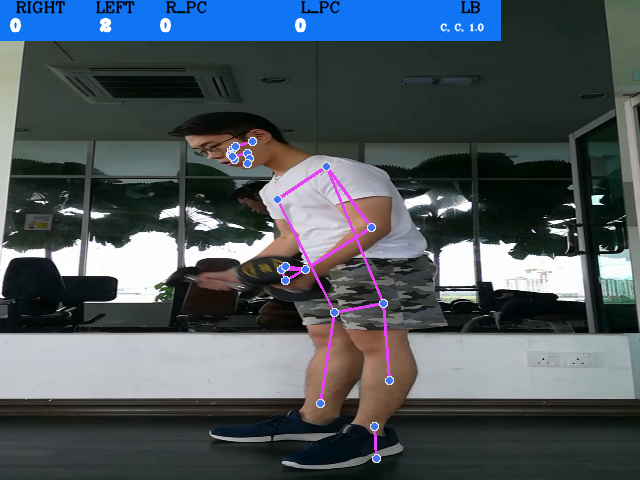

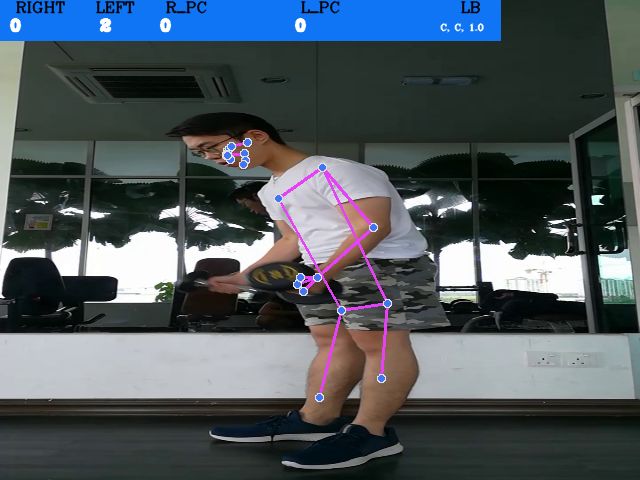

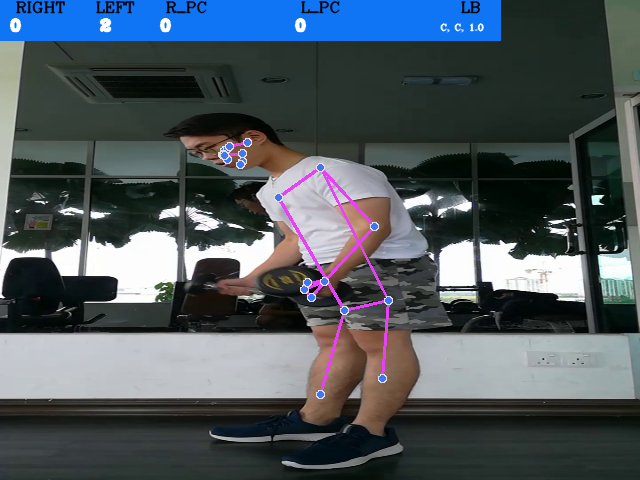

In [ ]:
import cv2
import mediapipe as mp
import numpy as np
import pandas as pd
from google.colab.patches import cv2_imshow  # Use this for displaying images in Colab

# Initialize MediaPipe and the Pose solution
mp_pose = mp.solutions.pose
mp_drawing = mp.solutions.drawing_utils

# Load your trained model and scaler (you need to have these ready)
# sklearn_model = load your trained model
# input_scaler = load your trained scaler

# Constants
VISIBILITY_THRESHOLD = 0.65
STAGE_UP_THRESHOLD = 90
STAGE_DOWN_THRESHOLD = 120
PEAK_CONTRACTION_THRESHOLD = 60
LOOSE_UPPER_ARM_ANGLE_THRESHOLD = 40
POSTURE_ERROR_THRESHOLD = 0.7
posture = "C"

# Init analysis class
left_arm_analysis = BicepPoseAnalysis(
    side="left",
    stage_down_threshold=STAGE_DOWN_THRESHOLD,
    stage_up_threshold=STAGE_UP_THRESHOLD,
    peak_contraction_threshold=PEAK_CONTRACTION_THRESHOLD,
    loose_upper_arm_angle_threshold=LOOSE_UPPER_ARM_ANGLE_THRESHOLD,
    visibility_threshold=VISIBILITY_THRESHOLD
)

right_arm_analysis = BicepPoseAnalysis(
    side="right",
    stage_down_threshold=STAGE_DOWN_THRESHOLD,
    stage_up_threshold=STAGE_UP_THRESHOLD,
    peak_contraction_threshold=PEAK_CONTRACTION_THRESHOLD,
    loose_upper_arm_angle_threshold=LOOSE_UPPER_ARM_ANGLE_THRESHOLD,
    visibility_threshold=VISIBILITY_THRESHOLD
)

# Define the video source (Use 0 for the webcam, or provide the path to a video file)
cap = cv2.VideoCapture(VIDEO_DEMO_PATH)  # For webcam use '0', for video file provide path

with mp_pose.Pose(min_detection_confidence=0.8, min_tracking_confidence=0.8) as pose:
    while cap.isOpened():
        ret, image = cap.read()

        if not ret:
            break

        # Reduce size of the frame for faster processing (optional)
        image = cv2.resize(image, (640, 480))  # Resize to half

        video_dimensions = [image.shape[1], image.shape[0]]

        # Recolor image from BGR to RGB for MediaPipe
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image_rgb.flags.writeable = False

        # Process the image to get pose landmarks
        results = pose.process(image_rgb)

        if not results.pose_landmarks:
            print("No human found")
            continue

        # Draw pose landmarks
        image.flags.writeable = True
        image = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2BGR)
        mp_drawing.draw_landmarks(
            image,
            results.pose_landmarks,
            mp_pose.POSE_CONNECTIONS,
            mp_drawing.DrawingSpec(color=(244, 117, 66), thickness=2, circle_radius=2),
            mp_drawing.DrawingSpec(color=(245, 66, 230), thickness=2, circle_radius=1)
        )

        try:
            # Extract landmarks
            landmarks = results.pose_landmarks.landmark

            # Analyze left and right arms
            (left_bicep_curl_angle, left_ground_upper_arm_angle) = left_arm_analysis.analyze_pose(landmarks, image)
            (right_bicep_curl_angle, right_ground_upper_arm_angle) = right_arm_analysis.analyze_pose(landmarks, image)

            # Extract important keypoints from frame for the input
            row = extract_important_keypoints(results, IMPORTANT_LMS)
            X = pd.DataFrame([row], columns=HEADERS[1:])
            X = pd.DataFrame(input_scaler.transform(X))

            # Make prediction and get its probability
            predicted_class = sklearn_model.predict(X)[0]
            prediction_probabilities = sklearn_model.predict_proba(X)[0]
            class_prediction_probability = round(prediction_probabilities[np.argmax(prediction_probabilities)], 2)

            # Update posture if the prediction is confident enough
            if class_prediction_probability >= POSTURE_ERROR_THRESHOLD:
                posture = predicted_class

            # Visualization
            cv2.rectangle(image, (0, 0), (500, 40), (245, 117, 16), -1)

            # Display counters and errors
            cv2.putText(image, "RIGHT", (15, 12), cv2.FONT_HERSHEY_COMPLEX, 0.5, (0, 0, 0), 1, cv2.LINE_AA)
            cv2.putText(image, str(right_arm_analysis.counter), (10, 30), cv2.FONT_HERSHEY_COMPLEX, 0.5, (255, 255, 255), 2, cv2.LINE_AA)

            cv2.putText(image, "LEFT", (95, 12), cv2.FONT_HERSHEY_COMPLEX, 0.5, (0, 0, 0), 1, cv2.LINE_AA)
            cv2.putText(image, str(left_arm_analysis.counter), (100, 30), cv2.FONT_HERSHEY_COMPLEX, 0.5, (255, 255, 255), 2, cv2.LINE_AA)

            # Display errors for both arms
            cv2.putText(image, "R_PC", (165, 12), cv2.FONT_HERSHEY_COMPLEX, 0.5, (0, 0, 0), 1, cv2.LINE_AA)
            cv2.putText(image, str(right_arm_analysis.detected_errors["PEAK_CONTRACTION"]), (160, 30), cv2.FONT_HERSHEY_COMPLEX, 0.5, (255, 255, 255), 2, cv2.LINE_AA)

            cv2.putText(image, "L_PC", (300, 12), cv2.FONT_HERSHEY_COMPLEX, 0.5, (0, 0, 0), 1, cv2.LINE_AA)
            cv2.putText(image, str(left_arm_analysis.detected_errors["PEAK_CONTRACTION"]), (295, 30), cv2.FONT_HERSHEY_COMPLEX, 0.5, (255, 255, 255), 2, cv2.LINE_AA)

            # Display posture error (lean back)
            cv2.putText(image, "LB", (460, 12), cv2.FONT_HERSHEY_COMPLEX, 0.5, (0, 0, 0), 1, cv2.LINE_AA)
            cv2.putText(image, f"{posture}, {predicted_class}, {class_prediction_probability}", (440, 30), cv2.FONT_HERSHEY_COMPLEX, 0.3, (255, 255, 255), 1, cv2.LINE_AA)

        except Exception as e:
            print(f"Error: {e}")

        # Display the frame in Colab
        cv2_imshow(image)

        # Optional: Break the loop if needed (e.g., after a certain number of frames)
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    cv2.destroyAllWindows()

    for i in range(1, 5):
        cv2.waitKey(1)
